In [1]:
import os
import pydub
from pydub import AudioSegment
import numpy as np

In [2]:
def extract_names(file):
    song_name,_,artist_name = file.partition(" - ")
    song_name = song_name[3:]

    artist_name,_,_ = artist_name.partition(".")
    
    return song_name, artist_name

In [3]:
def basic_feature_extraction(playlist):
    
    for song in playlist:
        
        song["frame_rate"] = song["audio_segment"].frame_rate
        
    return playlist

In [7]:
playlist = []

for root, dirs, files in os.walk("./songs/dev_songs", topdown=False):
    for file in files:
        
        audio_file = AudioSegment.from_wav(os.path.join(root, file))

        if audio_file.channels > 1:
            #make sure we are only using one channel. It may not matter.
            audio_file = audio_file.split_to_mono()[0]
        
        audio_array = np.array(audio_file.get_array_of_samples())
        
        song_name, artist_name = extract_names(file)
        
        path = os.path.join(root, file)
        
        song_dict = {
            "artist_name": artist_name,
            "song_name": song_name,
            "audio_segment": audio_file,
            "audio_array": audio_array,
            "song_path": path
        }

        playlist.append(song_dict)  

In [8]:

playlist = basic_feature_extraction(playlist)

#playlist = load_bpm(playlist)


In [9]:
print(playlist)

[{'artist_name': 'Heyson', 'song_name': 'Earn It', 'audio_segment': <pydub.audio_segment.AudioSegment object at 0x106ab3700>, 'audio_array': array([ 512,   -1,    0, ...,  256, -513, 1024], dtype=int32), 'song_path': './songs/dev_songs/ES_Earn It - Heyson.wav', 'frame_rate': 48000}, {'artist_name': 'Ingrid Witt', 'song_name': 'Another Kingdom Is Gone (Suedo Remix) (Instrumental Version)', 'audio_segment': <pydub.audio_segment.AudioSegment object at 0x106ab37c0>, 'audio_array': array([-14164737, -14017281, -13810945, ...,         0,         0,
               0], dtype=int32), 'song_path': './songs/dev_songs/ES_Another Kingdom Is Gone (Suedo Remix) (Instrumental Version) - Ingrid Witt.wav', 'frame_rate': 48000}]


In [12]:
from madmom.features.beats import RNNBeatProcessor
from madmom.features.beats import DBNBeatTrackingProcessor

test_song = playlist[0]

proc = DBNBeatTrackingProcessor(fps=100)
act = RNNBeatProcessor()(test_song["song_path"])
beat_times = proc(act)


In [ ]:
fps = test_song["frame_rate"]
beat_frames = (beat_times*fps).astype(int)
print(beat_frames)

In [45]:
#Create 0 and 1 array!!
onezeroarr = np.zeros_like(test_song["audio_array"])

In [46]:
from madmom.features.key import CNNKeyRecognitionProcessor

In [47]:
proc = CNNKeyRecognitionProcessor()
key_probabilities = proc(test_song["song_path"])

In [48]:
from madmom.features.key import key_prediction_to_label

In [49]:
key_label = key_prediction_to_label(key_probabilities)
print(key_label)

B major


In [50]:
num_beats = len(beat_times)
print(num_beats)
song_length = len(test_song["audio_array"])/fps/60
print(song_length)
bpm = num_beats/song_length
print(bpm)

418
3.475408333333333
120.27363691077068


In [47]:
import csv

with open("songs.csv", "r") as file:
    csv_reader = csv.DictReader(file,delimiter=",")
    playlist_true_bpm = list(csv_reader)

In [48]:

for song in playlist:
    flag = 0
    for song_ref in playlist_true_bpm:
        if song["song_name"] == song_ref["song_name"]:
            song["true_bpm"] = song_ref["bpm"]
            flag = 1
    if flag == 0:
        print("No true bpm found for song:", song["song_name"])

In [40]:
for song in playlist:
    print(song.get("true_bpm"))

122
124
117
123
125
128
125
120
124
126
126
120
124
125
125
123
124


In [2]:
import librosa, librosa.display



In [3]:
import IPython.display as ipd

In [15]:
file = "./ES_Earn It - Heyson.wav"
x, sr = librosa.load(file)
ipd.Audio(x, rate=sr)

In [23]:
x_fast = librosa.effects.time_stretch(x, 1.001)
ipd.Audio(x_fast, rate=sr)

In [26]:
import soundfile
import rubberband as rb

In [59]:
data,rate=soundfile.read('ES_Earn It - Heyson.wav',dtype='int16')
data = data[:,0]
bitrate=rate*16
nFrames=len(data)
print(f'Raw input type is : {type(data)}')

Raw input type is : <class 'numpy.ndarray'>


In [64]:
oldDuration=nFrames/rate
newDuration=300
ratio=newDuration/oldDuration
print(oldDuration)
print(ratio)

212.09010416666666
1.4144931522323698


In [65]:
out=rubberband.stretch(data,rate=rate,ratio=ratio,crispness=5,formants=False,precise=True)
soundfile.write('outfile.wav',out,rate,'PCM_16')

In [121]:
from pydub import AudioSegment
from scipy.io.wavfile import write
import numpy as np

audio_file = AudioSegment.from_wav('./songs/dev_songs_house/ES_Lepiten Falls - Ooyy.wav')

if audio_file.channels > 1:
    #make sure we are only using one channel. It may not matter.
    print('yes')
    audio_file_mono = audio_file.split_to_mono()[0]

frame_rate = audio_file_mono.frame_rate

yes


In [56]:
def store_song(mix, path):
    
    write(path, rate=frame_rate, data=mix.astype("int32"))

In [165]:

audio_array = np.array(audio_file_mono.get_array_of_samples(), dtype=float)


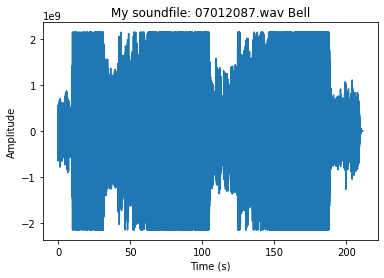

In [166]:
import matplotlib.pyplot as plt
time_scale = np.arange(len(audio_array)) / frame_rate

store_song(audio_array,'./songs/dev_songs_house_output/normal_song.wav')

plt.title("My soundfile: 07012087.wav Bell")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.plot(time_scale, audio_array)
plt.show()

In [167]:
fade_array = audio_array

fade_seconds = 20
fade_frames = fade_seconds*frame_rate

for i in range(fade_frames):
    fade_array[-i] = fade_array[-i]*(1.1-np.exp(2.398*(1-i/fade_frames))*0.1)


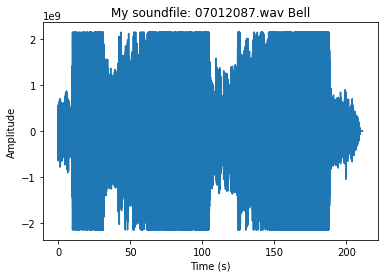

In [168]:
plt.title("My soundfile: 07012087.wav Bell")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.plot(time_scale, fade_array)
plt.show()

In [169]:
store_song(fade_array,'./songs/dev_songs_house_output/fade_song.wav')
